In [2]:
import scipy 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import io
import matplotlib.animation as animation
from IPython.display import HTML
import random
import sklearn.cluster
from scipy.optimize import curve_fit

# loading in/cleaning data

In [3]:
mat = io.loadmat('TwentyMinutes.mat')
mat = mat['twentyMinutes'][0]

# len(mat) = 114 (one frame)
# len of any given element of mat is 9 (features recorded per frame)

# the 9 features in order are
# ImageData
# ExperimentTime
# Color (1 is GFP = Hog1 expression; 2 is RFP = nuclear protein expression)
# BlueExposure
# GreenExposure
# FrameRateHertz (don't care)
# Configuration (don't care)
# ImagingPeriodSeconds
# StepFrequencyHz 

df = pd.DataFrame(columns = ['ImageData', 'ExperimentTime', 'Color', 
                            'BlueExposure', 'GreenExposure', 'ImagingPeriodSeconds', 
                            'StepFrequencyHz'])
                  
df['ImageData'] = list(mat[i][0] for i in range(114))
df['ExperimentTime'] = list(mat[i][1][0][0] for i in range(114))
df['Color'] = list(mat[i][2][0][0] for i in range(114))
df['BlueExposure'] = list(mat[i][3][0][0] for i in range(114))
df['GreenExposure'] = list(mat[i][4][0][0] for i in range(114))
df['ImagingPeriodSeconds'] = list(mat[i][7][0][0] for i in range(114))
df['StepFrequencyHz'] = list(mat[i][8][0] for i in range(114))

# visualization

In [ ]:
# show one frame
plt.imshow(df.ImageData[0], cmap='Greys')

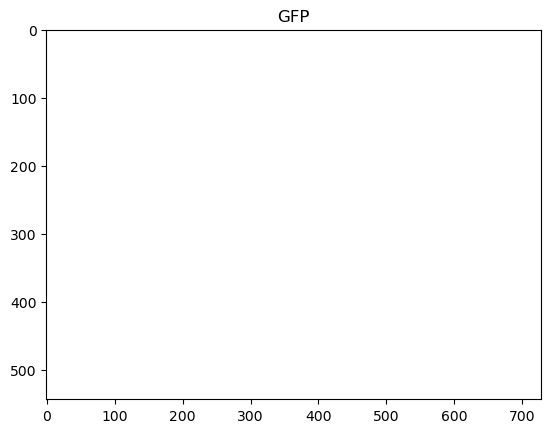

In [6]:
# make a movie from all of the frames 

# GFP FRAMES ARE EVEN-INDEXED!! 
GFP_images = np.array(df.ImageData[slice(0, len(df), 2)])
def movie(im_arrays, title='movie'):
    ''' animate a bunch of image frames into a movie ''' 
    frames = [] # for storing the generated images
    fig = plt.figure()
    for i in range(len(im_arrays)):
        frames.append([plt.imshow(im_arrays[i], cmap='Greys',animated=True)])

    ani = animation.ArtistAnimation(fig, frames, interval=100, blit=True,
                                    repeat_delay=1000)

    plt.title(title)
    plt.show()
    return ani
    
HTML(movie(GFP_images, 'GFP').to_jshtml())

In [1]:
# RFP FRAMES ARE ODD-INDEXED!!
RFP_images = np.array(df.ImageData[slice(1, len(df), 2)])
HTML(movie(RFP_images, 'RFP').to_jshtml())

# segmentation - attempt 1 - gave up

In [ ]:
# set img to be the first GFP image, just for ease
img = df.ImageData[0]

def process(image, plot=10):
    ''' the image processing pipeline yayyy
    plot is an optional int; if it's nonzero, will RANDOMLY plot a few instances
    of threshold mask and original image; the larger `plot` is, the less are plotted
    ''' 
    img = image.copy() # copy to be safe
    
    # INCREASE CONTRAST (barely helps)
    # scale to be between 0 and 255, then convert to uint8 datatype
    img = (img - np.min(img)) * (255 / (np.max(img) - np.min(img)))
    img = img.astype(np.uint8)

    # increase contrast with equalizeHist
    img = cv2.equalizeHist(img)
    # plt.imshow(img, cmap='Greys')

    
    # SHARPEN IMAGE (doesn't really do much...)
    # Apply GaussianBlur to the grayscale image to reduce noise
    img = cv2.GaussianBlur(img, (5, 5), 0)

    # Apply Unsharp Masking to sharpen the image
    img = cv2.addWeighted(img, 1.5, im, -0.5, 0)
    
    
    # THRESHOLD TO ONLY KEEP YEAST
    # Apply binary threshold to create a mask of pixels above the threshold
    threshold_value = 230  # Adjust this value as needed
    _, threshold_mask = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)
    
    # plot if desired
    if plot and random.randint(1,plot) == 4:
        fig, axs = plt.subplots(1,2)

        axs[0].imshow(img)
        axs[1].imshow(threshold_mask)

    return threshold_mask

In [ ]:
img_uint8 = (img - np.min(img)) * (255 / (np.max(img) - np.min(img)))
img_uint8 = img_uint8.astype(np.uint8)

In [ ]:
# Apply binary threshold to create a mask of pixels above the threshold
threshold_value = 210  # Adjust this value as needed
_, threshold_mask = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)


# plot
fig, axs = plt.subplots(1,2)

axs[0].imshow(img)
axs[1].imshow(threshold_mask)

In [ ]:
GFP_images = np.array(df.ImageData[slice(0, len(df), 2)])
GFP_images = np.array(list(process(array) for array in GFP_images))
HTML(movie(GFP_images, 'GFP').to_jshtml())

#  k means clustering - attempt 2 - yay?!

In [4]:
def get_clusters(w3):
    ''' use k means clustering to identify the centers of the yeasts.
    this assumes yeast are spherical (that's just an inherent assumption of k means) 
    '''
    # cluster the remaining valid points (w3, see below cell) to get the centers of the yeast spheres
    km = sklearn.cluster.KMeans(n_clusters=55,n_init=10)  # caps at 55 yeast
    pred = km.fit_predict(w3)
    return km.cluster_centers_

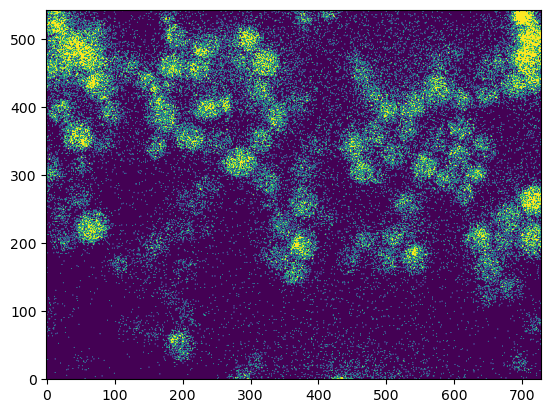

In [7]:
# for each GFP image, find "cluster centers" which are the centers of each (assumed spherical)
# yeast cell, using k means clustering

gs = []
w3s = []
cluster_centers = []
for image_ind in range(57):
    image = GFP_images[image_ind]

    # clean up the image by creating a binary image with threshold at 85% of original image values
    g = image>np.percentile(image.ravel(),85)
    gs.append(g)
    plt.imshow(g,origin='lower')

    # indices of points that are in the top 15% of original values
    # these points are potential valid images
    w = np.where(g)
    w2 = np.column_stack(w)

    # each circle has a radius of about 20 pixels
    # go through each valid point and compute the average number of pixels in the box around this point
    bound = int(20/np.sqrt(2))
    x_lb,x_ub = w2[:,0]-bound,w2[:,0]+bound
    y_lb,y_ub = w2[:,1]-bound,w2[:,1]+bound
    
    # remove points that go off the grid
    tf = (x_lb >= 0) & (x_ub < g.shape[0]) & (y_lb>=0) & (y_ub < g.shape[1])
    w2 = w2[tf]
    x_lb,x_ub = w2[:,0]-bound,w2[:,0]+bound
    y_lb,y_ub = w2[:,1]-bound,w2[:,1]+bound
    nums2 = np.asarray([g[x1:x2,y1:y2].mean() for x1,x2,y1,y2 in zip(x_lb,x_ub,y_lb,y_ub)])
    
    # keep the points whose box is at least 40% full - these are the possible valid points
    tf = nums2>0.4
    nums3 = nums2[tf]
    w3 = w2[tf]
    w3s.append(w3)
    cluster_centers.append(get_clusters(w3))

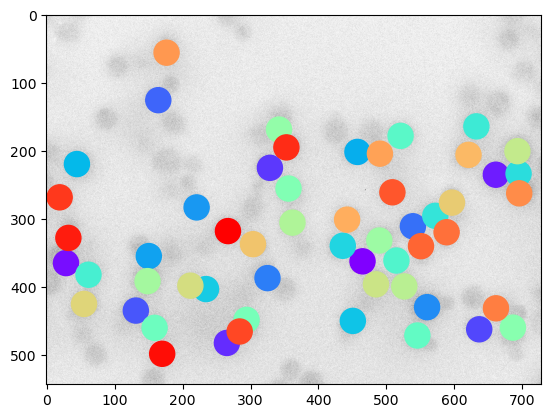

In [8]:
# make a movie from all of the frames, with colorful dots on each cluster

# Create a figure and axis
fig, ax = plt.subplots()

# Initialize the plot with the first frame
im1 = ax.imshow(GFP_images[0], cmap='Greys')
colors = plt.cm.rainbow(np.linspace(0, 1, len(cluster_centers[0])))
ax.scatter(*cluster_centers[0][:,::-1].T, s=325, c=colors)

# Function to update the plot in each frame of the animation
def update(frame):
    # breakpoint()
    # Clear the previous plot
    ax.cla()
    # Get the images for the current frame
    current_frame_images = GFP_images[frame], cluster_centers[frame]
    # Plot the first image
    ax.imshow(current_frame_images[0], cmap='Greys')
    # Overlay the second image with an alpha value to control transparency
    colors = plt.cm.rainbow(np.linspace(0, 1, len(current_frame_images[1])))
    ax.scatter(*current_frame_images[1][:,::-1].T, s=325, c=colors)
    return im1,

# Create an animation
ani = animation.FuncAnimation(fig, update, frames=range(len(w3s)), interval=200)

# Show the animation
# plt.show()
HTML(ani.to_jshtml())

In [9]:
#### A BUNCH OF HELPER FUNCTIONS

def find_closest_successor(cluster_center, frame_number):
    ''' given a cluster center in frame i, find the closest cluster center in frame i+1,
    which (roughly) should correspond to the same yeast cell at the next time step '''
    next_clusters = cluster_centers[frame_number+1]
    distances = np.sum( (next_clusters - cluster_center)**2 , axis=1)  # technically distances squared
    index_of_closest_successor = np.argmin(distances)
    closest_successor = next_clusters[index_of_closest_successor]
    
    THRESHOLD_DISTANCE = 80
    
    # issue: in a certain frame, it's possible that the cell isn't segmented correctly and disappears 
    # from that frame. In this case, we want to try interpolating with the next frame
    if np.min(distances) > THRESHOLD_DISTANCE and frame_number < len(cluster_centers) - 4:  
        # can vary the above threshold of 100; this matters when distance jumps more than expected
        
        # get 2 frames after the immediate successor
        grandchild_clusters = cluster_centers[frame_number+2]
        great_grandchild_clusters = cluster_centers[frame_number+3]
        distances_grandchild = np.sum( (grandchild_clusters - cluster_center)**2 , axis=1)
        distances_great_grandchild = np.sum( (great_grandchild_clusters - cluster_center)**2 , axis=1)
        index_of_closest_grandchild = np.argmin(distances_grandchild)
        index_of_closest_great_grandchild = np.argmin(distances_great_grandchild)
        closest_grandchild = grandchild_clusters[index_of_closest_grandchild]
        closest_great_grandchild = great_grandchild_clusters[index_of_closest_great_grandchild]
        
        # average over all 3 next frames (successor, grandchild, great grandchild)
        closest_successor = np.mean([closest_successor, 
                                    closest_grandchild,
                                    closest_great_grandchild], axis=0)
        
    elif np.min(distances) > THRESHOLD_DISTANCE and frame_number == len(cluster_centers) - 4:
        # don't have frames afterward to rely on for data/interpolation, 
        # so just use the most recent position
        closest_successor = find_closest_successor(cluster_center, frame_number - 1)
        
    elif np.min(distances) > THRESHOLD_DISTANCE and frame_number == len(cluster_centers) - 3:
        # don't have frames afterward to rely on for data/interpolation, 
        # so just use the most recent position
        closest_successor = find_closest_successor(cluster_center, frame_number - 2)
        
    elif np.min(distances) > THRESHOLD_DISTANCE and frame_number == len(cluster_centers) - 2:
        # don't have frames afterward to rely on for data/interpolation, 
        # so just use the most recent position
        closest_successor = find_closest_successor(cluster_center, frame_number - 3)
        
    
    # round to int so that you can index with this!
    return np.round(closest_successor).astype(int)

# isolate image of that yeast
def plot_single_yeast(center_y, center_x, frame_number=0):
    ''' return sub_image (np array) isolating a single yeast '''
    image = GFP_images[frame_number]

    # Define the coordinates of the sub-image
    width = 70
    height = 70
    top_left_x = center_x - width//2
    top_left_y = center_y - width//2

    # Extract the sub-image using array slicing
    sub_image = image[top_left_y:top_left_y+height, top_left_x:top_left_x+width]
    
    return sub_image

# plot trajectory of single yeast (images at each time point)
def plot_trajectory_single_yeast(initial_position=(206, 620), plot_photobleaching=False,
                                plot_cells=False):
    ''' given the initial position of a single yeast of interest (i.e. cluster center), 
    plots on one figure (with a bunch of subplots) that same yeast at each time point 
    '''
    num_images = len(cluster_centers)
    average_pixel_values = [] # this basically just measures photobleaching
    variance_pixel_values = []  # higher value should correspond to higher GFP signal
    centroids = [initial_position]
    
    position = initial_position  # y AND THEN x!!!! this is how cluster_centers is for some reason

    # Calculate the number of rows and columns for subplots
    num_rows = int(np.ceil(np.sqrt(num_images)))
    num_cols = int(np.ceil(num_images / num_rows))

    # Create a figure and axes for subplots
    if plot_cells:
        fig, axs = plt.subplots(num_rows, num_cols, figsize=(10, 10))
    
    # plot initial position
    sub_image = plot_single_yeast(*position, frame_number=0)
    if plot_cells:
        ax = axs.flat[0]
        ax.imshow(sub_image, cmap='gray')
        ax.set_title('0')
    
    average_pixel_values = [np.sum(sub_image) / sub_image.size] # higher value should correspond to higher GFP signal
    variance_pixel_values = [np.var(sub_image)]
    
    for frame_number in range(0, len(cluster_centers)-1):
        position = find_closest_successor(position, frame_number).tolist()
        sub_image = plot_single_yeast(*position, frame_number+1)
        if plot_cells:
            ax = axs.flat[frame_number+1]
            ax.imshow(sub_image, cmap='gray')
            ax.set_title(frame_number+1)
        
        average_pixel_values.append(np.sum(sub_image) / sub_image.size)
        variance_pixel_values.append(np.var(sub_image))
        centroids.append(position)
        
    if plot_cells:
        # Adjust layout
        plt.tight_layout()
        plt.title(f'Initial position: {initial_position}')
        plt.show()
    
    if plot_photobleaching:
        plt.figure()
        plt.scatter(np.arange(len(cluster_centers)), average_pixel_values)
        plt.title('Photobleaching')
        plt.ylabel('Average pixel value')
        plt.xlabel('Frame number')
        plt.show()
    
    plt.figure()
    plt.scatter(np.arange(len(cluster_centers)), variance_pixel_values)
    plt.title(f'GFP signal; initial position is {initial_position}')
    plt.ylabel('Variance of pixel value')
    plt.xlabel('Frame number')

    
    #### TRYING TO FIT CURVE TO GFP SIGNAL DATA; needs a lot of work before it works :(
    # Define the exponential decay cosine function
#     def decay_cosine(x, a, b, c, d):
#         return a * np.exp(-b * x) * np.cos(c * x + d)
    
#     # Fit the model to the data
#     initial_guesses = [40000, 8000, 1/15, 0]
#     try:
#         popt, pcov = curve_fit(decay_cosine, np.arange(len(cluster_centers)), variance_pixel_values,
#                               p0=initial_guesses)
#         plt.plot(np.arange(len(cluster_centers)), decay_cosine(np.arange(len(cluster_centers)), *popt), 
#                                                           color='red', label='Fitted curve')
#     except:
#         pass
    
    ####
    
    plt.show()
    
    plt.figure()
    centroids_y = list(centroid[0] for centroid in centroids)
    centroids_x = list(centroid[1] for centroid in centroids)
    for i in range(len(centroids_x)):
        plt.scatter(centroids_x[i], centroids_y[i], color='blue')
        plt.text(centroids_x[i], centroids_y[i], str(i), ha='left', va='bottom')
    plt.title(f'Centroid positions; initial position is {initial_position}')
    plt.show()
    
def closest_cluster_center(position_guess):
    ''' given a rough guess of the position of a cluster center, 
    for example by eyeballing the colorful dot movie, 
    locates the true closest cluster in the initial frame 
    
    position_guess must be (y, x) !!!! just bc of how the clusters are ordered for some reason
    '''
    return find_closest_successor(position_guess, frame_number=-1)  # successor of frame #-1 is exactly initial frame!

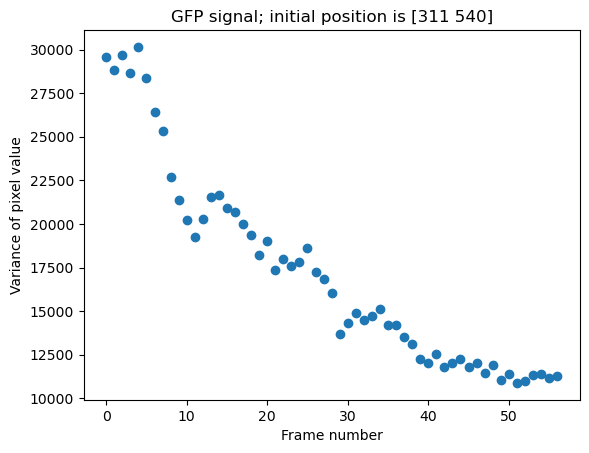

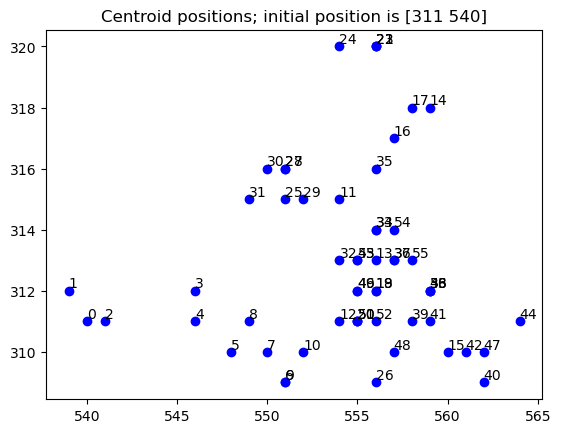

In [10]:
guess_of_desired_yeast_center = (300, 550)  # y and then x
plot_trajectory_single_yeast(initial_position=closest_cluster_center(guess_of_desired_yeast_center))

In [11]:
# try all of the yeast identified in the first frame. generates a ton of plots like above so run sparingly
for initial_position in cluster_centers[0]:
    plot_trajectory_single_yeast(initial_position=closest_cluster_center(initial_position))
    
# you can then basically cherry-pick from the plots below since this code is ofc imperfect